<a href="https://colab.research.google.com/github/ckanu13k/StableDiffusion/blob/main/Stable_Diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Stable Diffusion**

In [2]:
!nvidia-smi

Mon Jan 16 17:16:42 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   61C    P8    11W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
!pip install -q diffusers==0.10.0
!pip install -q transformers scipy ftfy accelerate
!pip install -q "ipywidgets>=7,<8"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 502.9/502.9 KB 20.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.4/182.4 KB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 76.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 KB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 191.5/191.5 KB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 104.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 6.0 MB/s eta 0:00:00


StableDiffusionPipeline is an end-to-end inference pipeline that you can use to generate images from text with just a few lines of code.

First, we load the pre-trained weights of all components of the model. In this notebook we use Stable Diffusion version 1.4 (CompVis/stable-diffusion-v1-4), but there are other variants that you may want to try:

runwayml/stable-diffusion-v1-5
stabilityai/stable-diffusion-2-1-base
stabilityai/stable-diffusion-2-1. This version can produce images with a resolution of 768x768, while the others work at 512x512.
In addition to the model id CompVis/stable-diffusion-v1-4, we're also passing a specific revision and torch_dtype to the from_pretrained method.

We want to ensure that every free Google Colab can run Stable Diffusion, hence we're loading the weights from the half-precision branch fp16 and also tell diffusers to expect the weights in float16 precision by passing torch_dtype=torch.float16.

If you want to ensure the highest possible precision, please make sure to remove revision="fp16" and torch_dtype=torch.float16 at the cost of a higher memory usage.

In [4]:
import torch
from diffusers import StableDiffusionPipeline

# make sure you're logged in with `huggingface-cli login`
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16)  

Downloading:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Downloading:   0%|          | 0.00/342 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.63k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/608M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/209 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/307 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/572 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/246M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/472 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/788 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/772 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/550 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/167M [00:00<?, ?B/s]

Next, let's move the pipeline to GPU to have faster inference.

In [5]:
pipe = pipe.to("cuda")

And we are ready to generate images:


  0%|          | 0/50 [00:00<?, ?it/s]

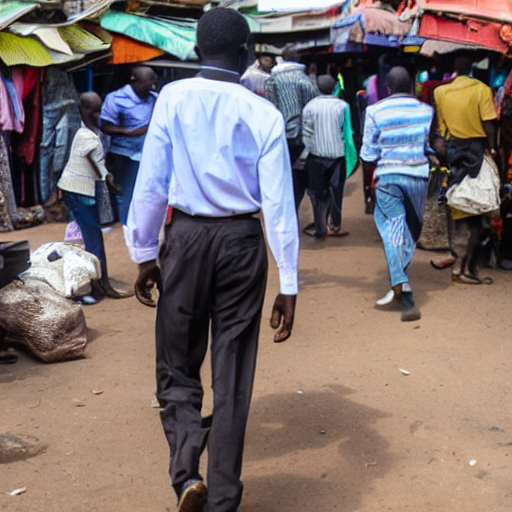

In [5]:
prompt = "a walking trader within a busy African market" #"a photograph of an astronaut riding a horse"
image = pipe(prompt).images[0]  # image here is in [PIL format](https://pillow.readthedocs.io/en/stable/)

# Now to display an image you can either save it such as:
#image.save(f"astronaut_rides_horse.png")
image.save(f"walking_trader_africanmarket.png")

# or if you're in a google colab you can directly display it with 
image

Why does there seem to be a bias with the inference - most tries show male walking trader

Running the above cell multiple times will give you a different image every time. If you want deterministic output you can pass a random seed to the pipeline. Every time you use the same seed you'll have the same image result.

  0%|          | 0/50 [00:00<?, ?it/s]

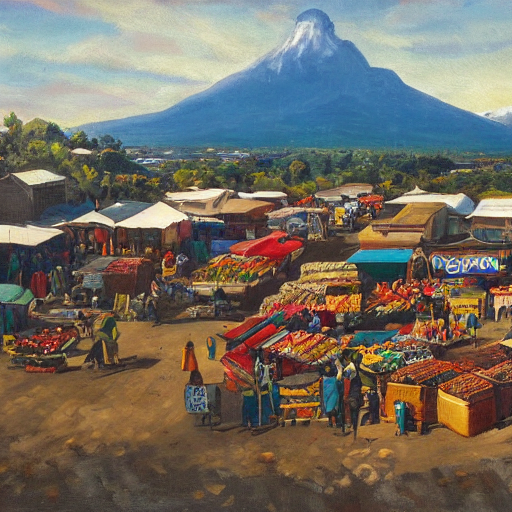

In [9]:
import torch

generator = torch.Generator("cuda").manual_seed(1024)

image = pipe(prompt, generator=generator).images[0]

image

  0%|          | 0/50 [00:00<?, ?it/s]

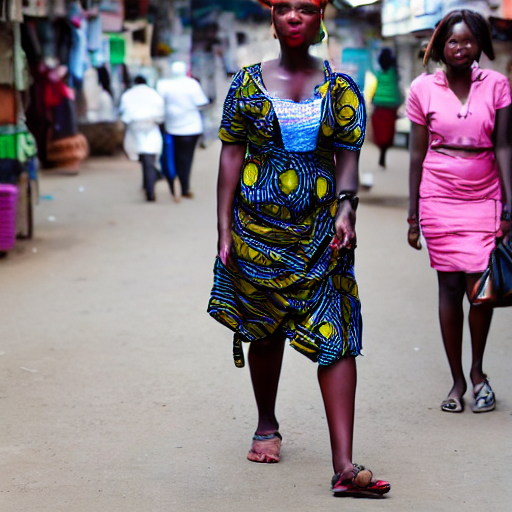

In [7]:
prompt = "a walking female trader within a busy African market" #"a photograph of an astronaut riding a horse"

image = pipe(prompt, generator=generator).images[0]

image

  0%|          | 0/900 [00:00<?, ?it/s]

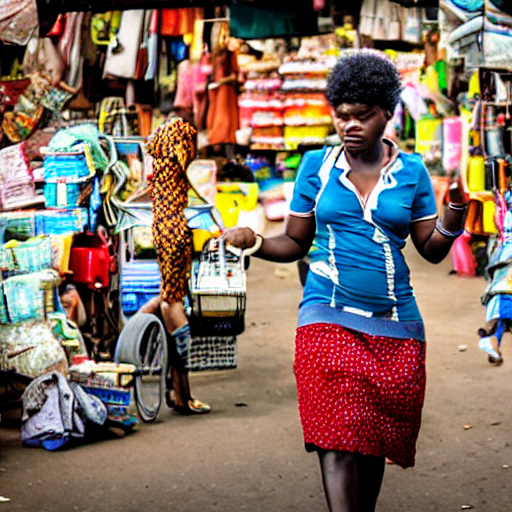

In [8]:
image = pipe(prompt, num_inference_steps=900, generator=generator).images[0]

image

Why are faces disfigured!


Let's first write a helper function to display a grid of images. Just run the following cell to create the image_grid function, or disclose the code if you are interested in how it's done.

In [9]:
from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

  0%|          | 0/50 [00:00<?, ?it/s]

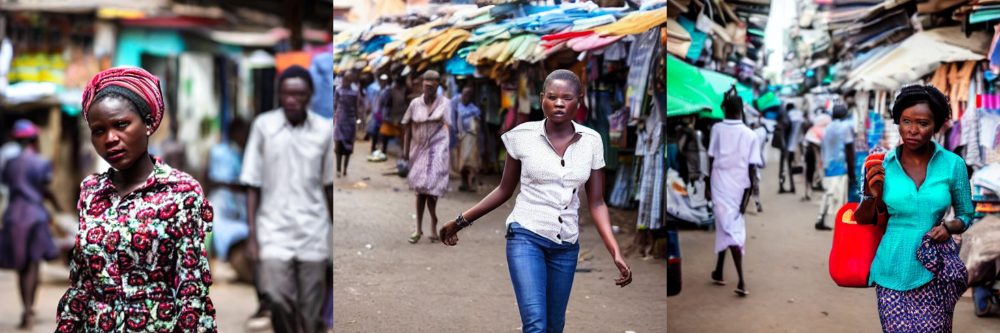

In [10]:
num_images = 3
prompt_list = [prompt] * num_images

images = pipe(prompt_list).images

grid = image_grid(images, rows=1, cols=3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

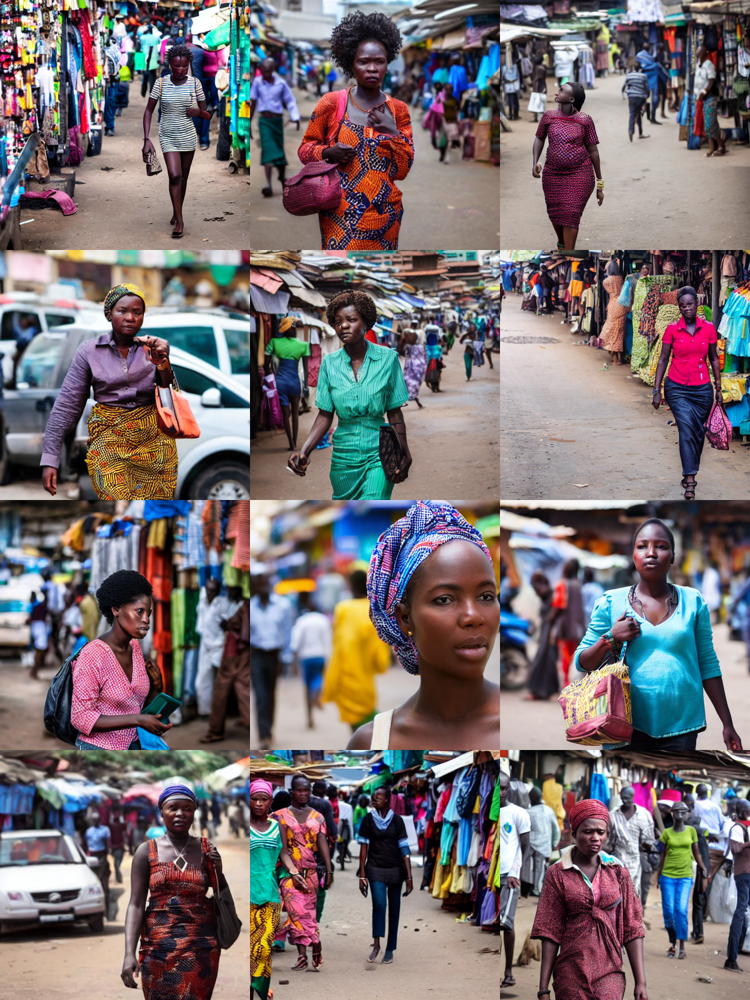

In [11]:
num_cols = 3
num_rows = 4

prompt_list = [prompt] * num_cols
#prompt = ["a photograph of an astronaut riding a horse"] * num_cols

all_images = []
for i in range(num_rows):
  images = pipe(prompt_list).images
  all_images.extend(images)

grid = image_grid(all_images, rows=num_rows, cols=num_cols)
grid

### Generate non-square images

Stable Diffusion produces images of `512 × 512` pixels by default. But it's very easy to override the default using the `height` and `width` arguments, so you can create rectangular images in portrait or landscape ratios.

These are some recommendations to choose good image sizes:
- Make sure `height` and `width` are both multiples of `8`.
- Going below 512 might result in lower quality images.
- Going over 512 in both directions will repeat image areas (global coherence is lost).
- The best way to create non-square images is to use `512` in one dimension, and a value larger than that in the other one.

  0%|          | 0/50 [00:00<?, ?it/s]

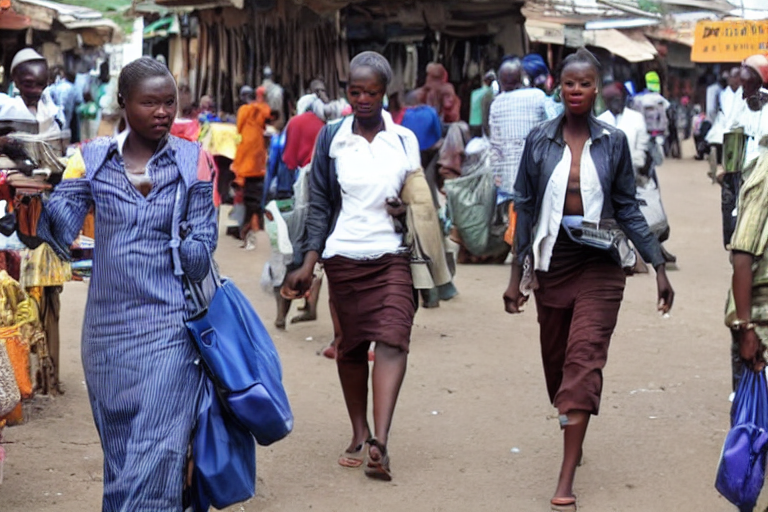

In [12]:
image = pipe(prompt, height=512, width=768).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

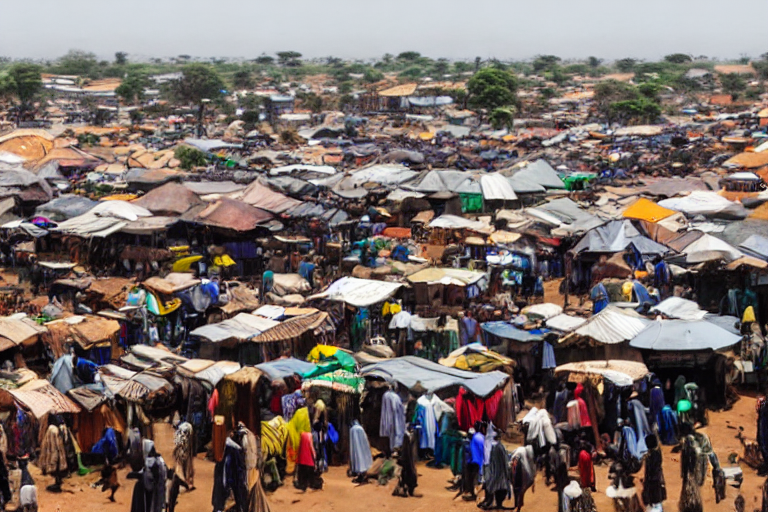

In [13]:
prompt = "an airy overview of a busy African market"
image = pipe(prompt, height=512, width=768).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

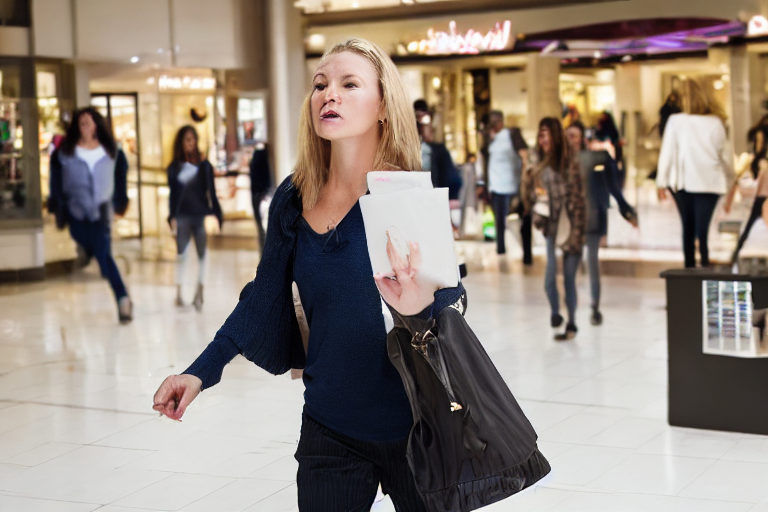

In [14]:
prompt = "a white woman walking through a busy Mall"
image = pipe(prompt, height=512, width=768).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

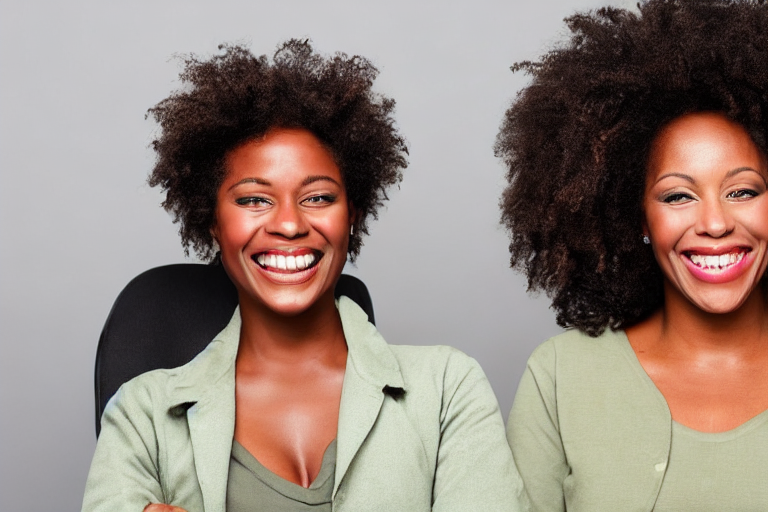

In [15]:
prompt = "the face of a black woman smiling"
image = pipe(prompt, height=512, width=768).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

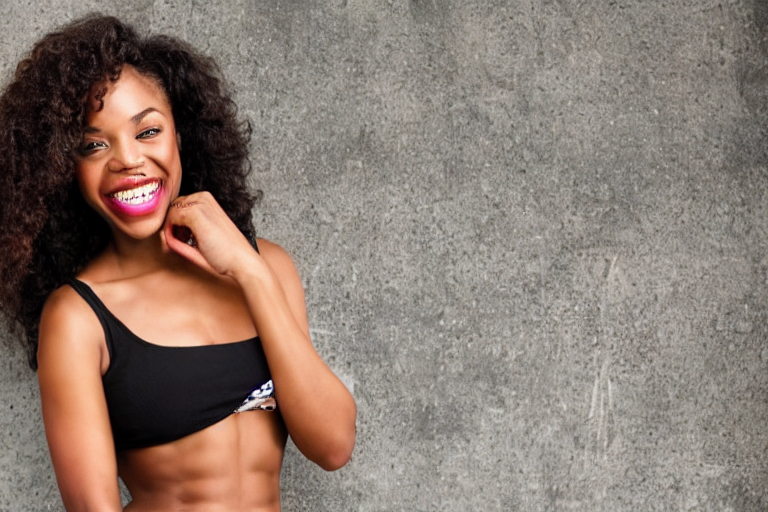

In [16]:
prompt = "the face of a black woman smiling. Also show her stomach up with cloths on"
image = pipe(prompt, height=512, width=768).images[0]
image

  0%|          | 0/900 [00:00<?, ?it/s]

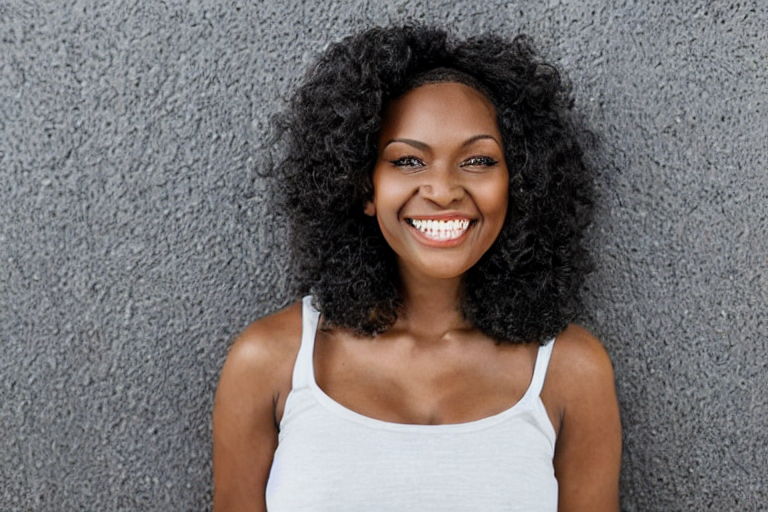

In [17]:
prompt = "the face of a black woman smiling. Also show her stomach up with cloths on"
image = pipe(prompt, num_inference_steps=900, height=512, width=768).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/900 [00:00<?, ?it/s]

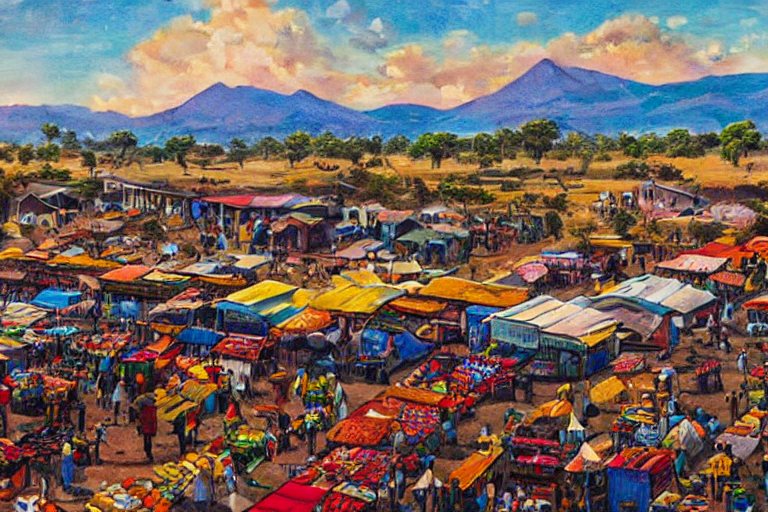

In [7]:
prompt = "a paiting of an airview of a African market alongside a Mountain view"
image = pipe(prompt, height=512, width=768).images[0]
image
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768).images[0]
image2


  0%|          | 0/900 [00:00<?, ?it/s]

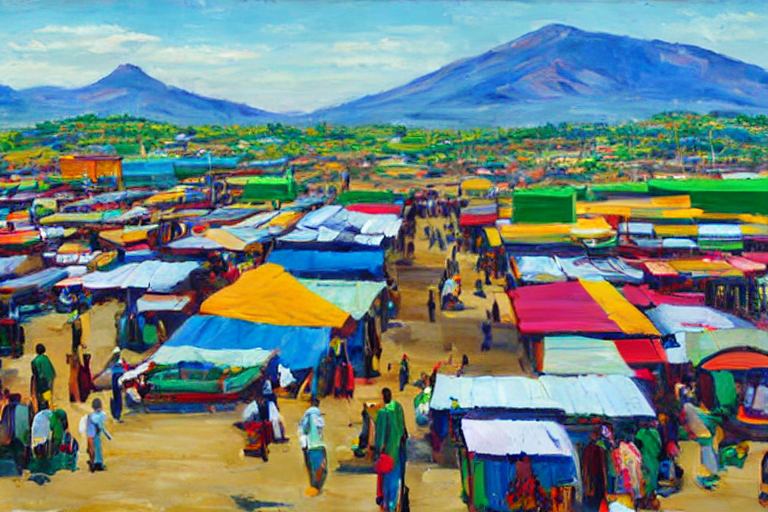

In [8]:
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768, guidance_scale=8.5).images[0]
image2

  0%|          | 0/900 [00:00<?, ?it/s]

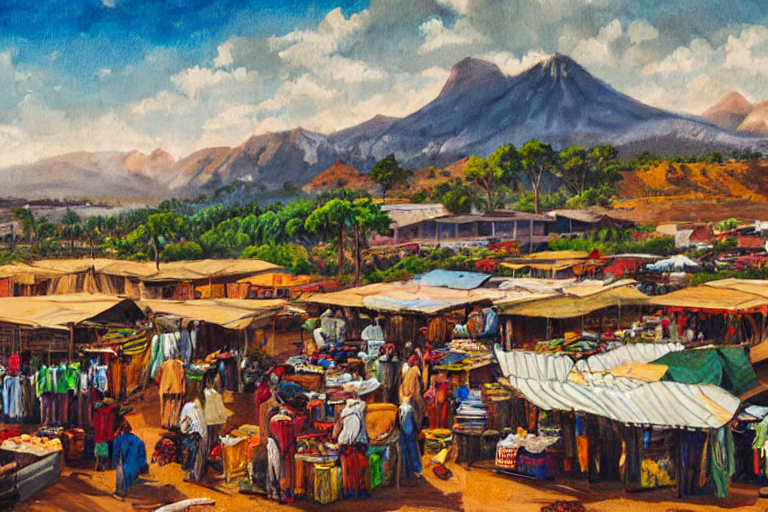

In [10]:
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768, guidance_scale=8.5, generator=generator).images[0]
image2

  0%|          | 0/900 [00:00<?, ?it/s]

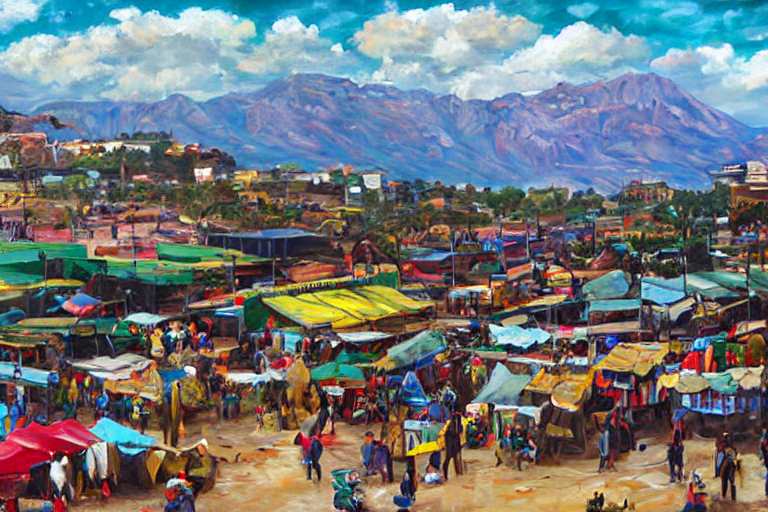

In [11]:
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768, guidance_scale=4.5, generator=generator).images[0]
image2

  0%|          | 0/900 [00:00<?, ?it/s]

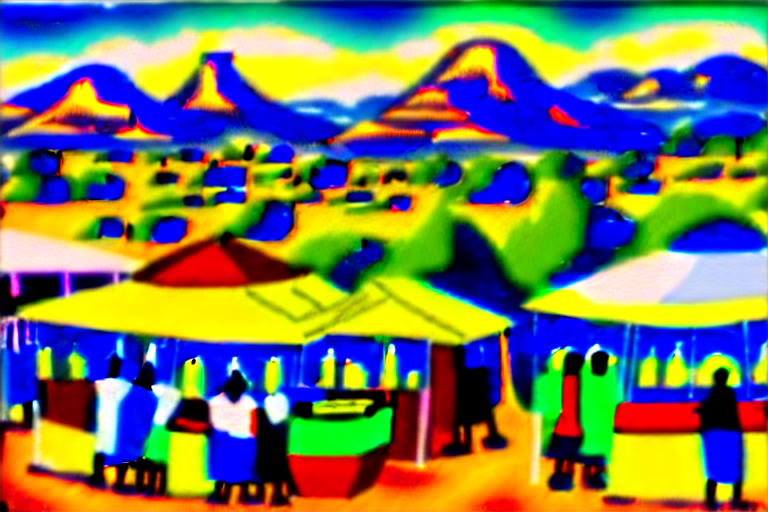

In [12]:
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768, guidance_scale=200, generator=generator).images[0]
image2

  0%|          | 0/900 [00:00<?, ?it/s]

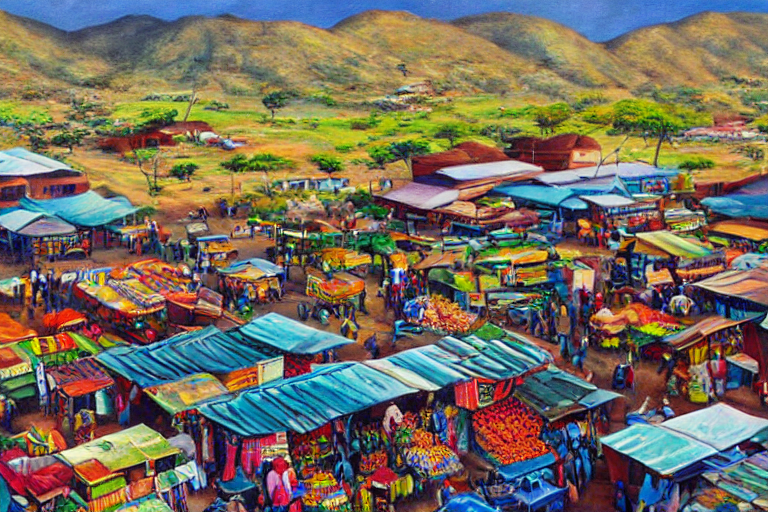

In [19]:
image2 = pipe(prompt, num_inference_steps=900, height=512, width=768, guidance_scale=8.5, generator=generator).images[0]
image2

In [20]:
print(image2.size)

(768, 512)


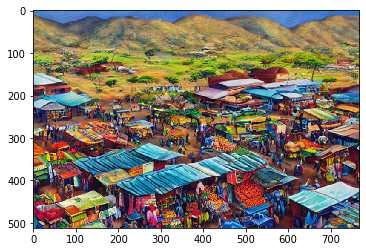

In [22]:
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

plt.imshow(image2, interpolation='none')
plt.savefig('plot.png', dpi = 2000)

In [23]:
!pip install -q ISR

ERROR: Cannot install isr==1.9.0, isr==1.9.1, isr==1.9.2, isr==1.9.3, isr==2.0.0, isr==2.0.1, isr==2.0.2, isr==2.0.5, isr==2.1, isr==2.1.1 and isr==2.2.0 because these package versions have conflicting dependencies.
ERROR: ResolutionImpossible: for help visit https://pip.pypa.io/en/latest/topics/dependency-resolution/#dealing-with-dependency-conflicts
